# View Fors2 

- author : Sylvie Dagoret-Campagne
- affiliation : IJCLab/IN2P3/CNRS
- creation date : 2022/12/19
- FORS2 : https://github.com/ericnuss/fors2
- Result of StarLight : /sps/lsst/groups/photoz/fors2/FORS2/ResStarlight



          /Users/dagoret/MacOSX/GitHub/LSST/FORS2>ls -l
              total 0
              drwxrwsr-x  3 dagoret  staff   96 Aug 21  2018 ResStarlight
              drwxr-xr-x  9 dagoret  staff  288 Dec 19 18:01 fors2

## Import

In [1]:
import os,sys
from astropy.io import fits

In [2]:
# Import some generally useful packages

import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cm as cmx

from matplotlib.backends.backend_pdf import PdfPages

%matplotlib inline
import pandas as pd
from itertools import cycle, islice


In [3]:
from scipy import ndimage

#from scipy import interp as scinterp
from scipy.interpolate import interp1d

import glob
import collections
#from def_raw_seds import *

In [4]:
# to enlarge the sizes
params = {'legend.fontsize': 'large',
          'figure.figsize': (8, 4),
         'axes.labelsize': 'xx-large',
         'axes.titlesize':'xx-large',
         'xtick.labelsize':'xx-large',
         'ytick.labelsize':'xx-large'}
plt.rcParams.update(params)


In [5]:
import matplotlib.offsetbox
props = dict(boxstyle='round',edgecolor="w",facecolor="w", alpha=0.5)


In [6]:
# Import the primary photometry classes from rubin_sim.photUtils

import rubin_sim.photUtils.Bandpass as Bandpass
import rubin_sim.photUtils.Sed as Sed
from rubin_sim.data import get_data_dir

In [7]:
pysynphot_root_path=os.environ['PYSYN_CDBS']
path_sed_calspec=os.path.join(pysynphot_root_path,'calspec')
# pysynphot
import pysynphot as S
S.refs.setref(area=1)
S.refs.getref()

{'graphtable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/14l1632sm_tmg.fits',
 'comptable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/16n1832tm_tmc.fits',
 'thermtable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/tae17277m_tmt.fits',
 'area': 1,
 'waveset': 'Min: 500, Max: 26000, Num: 10000, Delta: None, Log: True'}

## Configuration

In [8]:
! ls ../../fors2

ResStarlight fors2


In [9]:
l0=['SPEC2','SPEC3','SPEC9','SPEC13','SPEC19','SPEC24','SPEC25','SPEC30','SPEC31','SPEC32','SPEC33','SPEC34','SPEC35','SPEC36','SPEC37','SPEC45','SPEC47','SPEC49','SPEC51','SPEC55','SPEC57','SPEC58','SPEC59','SPEC61','SPEC62','SPEC66','SPEC67','SPEC68','SPEC69','SPEC70','SPEC71','SPEC72','SPEC73','SPEC77','SPEC79','SPEC80','SPEC83','SPEC84','SPEC85','SPEC86','SPEC87','SPEC89','SPEC91','SPEC93','SPEC96','SPEC97']
l1=['SPEC102','SPEC106','SPEC107','SPEC109','SPEC110','SPEC111','SPEC112','SPEC113','SPEC114','SPEC115','SPEC117','SPEC118','SPEC120','SPEC121','SPEC123','SPEC127','SPEC128','SPEC132','SPEC134','SPEC135','SPEC137','SPEC138','SPEC141','SPEC149','SPEC151','SPEC152','SPEC156','SPEC160','SPEC161','SPEC164','SPEC171','SPEC178','SPEC179','SPEC181','SPEC182','SPEC184','SPEC185','SPEC186','SPEC187','SPEC188','SPEC189','SPEC191','SPEC192','SPEC193','SPEC194','SPEC196','SPEC197','SPEC198']
l2=['SPEC204','SPEC205','SPEC210','SPEC214','SPEC218','SPEC221','SPEC222','SPEC223','SPEC226','SPEC227','SPEC231','SPEC233','SPEC234','SPEC235','SPEC236','SPEC237','SPEC238','SPEC240','SPEC242','SPEC243','SPEC244','SPEC245','SPEC246','SPEC248','SPEC249','SPEC250','SPEC252','SPEC253','SPEC258','SPEC259','SPEC260','SPEC261','SPEC262','SPEC264','SPEC265','SPEC266','SPEC267','SPEC268','SPEC271','SPEC274','SPEC275','SPEC276','SPEC277','SPEC278','SPEC279','SPEC280','SPEC281','SPEC282','SPEC283','SPEC287','SPEC288','SPEC291','SPEC292','SPEC294','SPEC295','SPEC296','SPEC297','SPEC298']
l3=['SPEC301','SPEC302','SPEC303','SPEC305','SPEC306','SPEC307','SPEC308','SPEC309','SPEC313','SPEC315','SPEC317','SPEC318','SPEC319','SPEC321','SPEC322','SPEC323','SPEC324','SPEC325','SPEC326','SPEC327','SPEC328','SPEC329','SPEC331','SPEC332','SPEC333','SPEC334','SPEC335','SPEC336','SPEC337','SPEC338','SPEC339','SPEC340','SPEC341','SPEC343','SPEC344','SPEC345','SPEC348','SPEC349','SPEC350','SPEC351','SPEC352','SPEC353','SPEC354','SPEC355','SPEC357','SPEC358','SPEC359','SPEC360','SPEC361','SPEC362','SPEC363','SPEC364','SPEC365','SPEC366','SPEC367','SPEC368','SPEC369','SPEC370','SPEC371','SPEC372','SPEC373','SPEC374','SPEC375','SPEC376','SPEC377','SPEC378','SPEC379','SPEC380','SPEC381','SPEC382','SPEC383','SPEC384','SPEC385','SPEC386','SPEC387','SPEC388','SPEC389','SPEC390','SPEC391','SPEC392','SPEC393','SPEC394','SPEC395','SPEC396','SPEC397','SPEC398','SPEC399']
l4=['SPEC400','SPEC401','SPEC402','SPEC403','SPEC404','SPEC405','SPEC406','SPEC407','SPEC408','SPEC409','SPEC410','SPEC411','SPEC412','SPEC413','SPEC414','SPEC415','SPEC416','SPEC417','SPEC418','SPEC419','SPEC420','SPEC421','SPEC422','SPEC423','SPEC424','SPEC425','SPEC426','SPEC427','SPEC428','SPEC429','SPEC430','SPEC431','SPEC434','SPEC435','SPEC436','SPEC437','SPEC438','SPEC439','SPEC440','SPEC441','SPEC442','SPEC443','SPEC444','SPEC445','SPEC446','SPEC447','SPEC448','SPEC449','SPEC450','SPEC451','SPEC452','SPEC453','SPEC454','SPEC455','SPEC456','SPEC457','SPEC458','SPEC459','SPEC460','SPEC461','SPEC462','SPEC463','SPEC464','SPEC465','SPEC466','SPEC467','SPEC468','SPEC469','SPEC470','SPEC471','SPEC472','SPEC474','SPEC475','SPEC477','SPEC478','SPEC479','SPEC480','SPEC481','SPEC482','SPEC483','SPEC488','SPEC490','SPEC492','SPEC493','SPEC494','SPEC496','SPEC497','SPEC499']
l5=['SPEC500','SPEC501','SPEC503','SPEC504','SPEC505','SPEC506','SPEC507','SPEC508','SPEC509','SPEC510','SPEC511','SPEC512','SPEC513','SPEC516','SPEC517','SPEC519','SPEC520','SPEC523','SPEC524','SPEC525','SPEC526','SPEC527','SPEC528','SPEC529','SPEC530','SPEC531','SPEC532','SPEC533','SPEC535','SPEC536','SPEC537','SPEC539','SPEC540','SPEC541','SPEC542','SPEC543','SPEC544','SPEC545','SPEC546','SPEC547','SPEC548','SPEC549','SPEC550','SPEC551','SPEC552','SPEC553','SPEC554','SPEC556','SPEC557','SPEC558','SPEC559','SPEC560','SPEC562','SPEC563','SPEC564','SPEC565','SPEC566','SPEC567','SPEC568','SPEC569','SPEC570','SPEC571','SPEC572','SPEC573','SPEC574','SPEC575','SPEC576','SPEC577','SPEC578','SPEC579','SPEC580','SPEC582','SPEC583','SPEC584','SPEC585','SPEC586','SPEC587','SPEC588','SPEC589','SPEC590','SPEC593','SPEC594','SPEC595','SPEC596','SPEC597','SPEC598','SPEC599']
l6=['SPEC600','SPEC601','SPEC602','SPEC603','SPEC604','SPEC605','SPEC606','SPEC608','SPEC609','SPEC610','SPEC611','SPEC612','SPEC613','SPEC617','SPEC618','SPEC620','SPEC621','SPEC622','SPEC623','SPEC624','SPEC625','SPEC626','SPEC627','SPEC628','SPEC629','SPEC630','SPEC631','SPEC633','SPEC634','SPEC635','SPEC636','SPEC637','SPEC638','SPEC639','SPEC640','SPEC641','SPEC642','SPEC643','SPEC644','SPEC645','SPEC646','SPEC647','SPEC648','SPEC649','SPEC650','SPEC651','SPEC652','SPEC653','SPEC654','SPEC655','SPEC656','SPEC657','SPEC658','SPEC660','SPEC661','SPEC662','SPEC663','SPEC664','SPEC667','SPEC668','SPEC669','SPEC670','SPEC671','SPEC672','SPEC673','SPEC674','SPEC675','SPEC676','SPEC677','SPEC678','SPEC679','SPEC680','SPEC681','SPEC682','SPEC683','SPEC684','SPEC685','SPEC686','SPEC687','SPEC689','SPEC690','SPEC691','SPEC692','SPEC693','SPEC694','SPEC695','SPEC696','SPEC697','SPEC698']
l7=['SPEC700','SPEC701','SPEC702','SPEC703','SPEC704','SPEC705','SPEC706','SPEC707','SPEC708','SPEC710','SPEC711','SPEC713','SPEC714','SPEC715','SPEC716','SPEC717','SPEC718','SPEC719','SPEC720','SPEC721','SPEC722','SPEC723','SPEC724','SPEC725','SPEC726','SPEC727','SPEC728','SPEC729','SPEC730','SPEC731','SPEC732','SPEC733','SPEC734','SPEC735','SPEC736','SPEC737','SPEC738']

In [10]:
##########################################################################
sel_0 = ['SPEC91', 'SPEC79', 'SPEC9', 'SPEC3', 'SPEC61', 'SPEC62', 'SPEC67', 'SPEC69', 'SPEC68', 'SPEC25', 'SPEC87', 'SPEC86', 'SPEC85', 'SPEC84', 'SPEC83', 'SPEC80', 'SPEC72', 'SPEC70', 'SPEC58', 'SPEC59', 'SPEC55', 'SPEC57', 'SPEC36', 'SPEC37', 'SPEC34', 'SPEC32', 'SPEC33', 'SPEC30', 'SPEC31'] 
sel_1 =  ['SPEC132', 'SPEC152', 'SPEC137', 'SPEC111', 'SPEC115', 'SPEC192', 'SPEC193', 'SPEC191', 'SPEC178', 'SPEC197', 'SPEC194', 'SPEC151', 'SPEC123', 'SPEC109', 'SPEC107', 'SPEC128', 'SPEC102', 'SPEC184', 'SPEC186', 'SPEC181', 'SPEC182', 'SPEC141', 'SPEC161', 'SPEC160'] 
sel_2 = ['SPEC271', 'SPEC277', 'SPEC278', 'SPEC253', 'SPEC252', 'SPEC218', 'SPEC238', 'SPEC210', 'SPEC235', 'SPEC234', 'SPEC233', 'SPEC214', 'SPEC231', 'SPEC291', 'SPEC292', 'SPEC294', 'SPEC297', 'SPEC296', 'SPEC260', 'SPEC248', 'SPEC205', 'SPEC264', 'SPEC265', 'SPEC267', 'SPEC242', 'SPEC243', 'SPEC246', 'SPEC244', 'SPEC245', 'SPEC227', 'SPEC221', 'SPEC222', 'SPEC223', 'SPEC282', 'SPEC280', 'SPEC281'] 
sel_3 =  ['SPEC351', 'SPEC379', 'SPEC372', 'SPEC376', 'SPEC375', 'SPEC315', 'SPEC394', 'SPEC396', 'SPEC391', 'SPEC393', 'SPEC398', 'SPEC343', 'SPEC344', 'SPEC364', 'SPEC348', 'SPEC363', 'SPEC321', 'SPEC306', 'SPEC325', 'SPEC301', 'SPEC387', 'SPEC386', 'SPEC385', 'SPEC384', 'SPEC383', 'SPEC382', 'SPEC381', 'SPEC380', 'SPEC388'] 
sel_4 =  ['SPEC471', 'SPEC447', 'SPEC441', 'SPEC442', 'SPEC488', 'SPEC480', 'SPEC461', 'SPEC412', 'SPEC410', 'SPEC438', 'SPEC415', 'SPEC414', 'SPEC419', 'SPEC436', 'SPEC478', 'SPEC457', 'SPEC475', 'SPEC455', 'SPEC454', 'SPEC453', 'SPEC452', 'SPEC474', 'SPEC499', 'SPEC493', 'SPEC496', 'SPEC494', 'SPEC418', 'SPEC466', 'SPEC468', 'SPEC402', 'SPEC463', 'SPEC460', 'SPEC407', 'SPEC409', 'SPEC421', 'SPEC424', 'SPEC469'] 
sel_5 = ['SPEC509', 'SPEC501', 'SPEC500', 'SPEC525', 'SPEC524', 'SPEC505', 'SPEC504', 'SPEC506', 'SPEC580', 'SPEC583', 'SPEC585', 'SPEC584', 'SPEC520', 'SPEC570', 'SPEC517', 'SPEC527', 'SPEC516', 'SPEC571', 'SPEC572', 'SPEC573', 'SPEC512', 'SPEC513', 'SPEC576', 'SPEC511', 'SPEC579', 'SPEC575', 'SPEC539', 'SPEC523', 'SPEC526', 'SPEC532', 'SPEC533', 'SPEC596', 'SPEC595', 'SPEC546', 'SPEC559', 'SPEC560', 'SPEC567', 'SPEC545', 'SPEC544', 'SPEC568', 'SPEC540', 'SPEC542'] 
sel_6 = ['SPEC602', 'SPEC603', 'SPEC601', 'SPEC606', 'SPEC605', 'SPEC664', 'SPEC667', 'SPEC662', 'SPEC647', 'SPEC645', 'SPEC642', 'SPEC643', 'SPEC625', 'SPEC698', 'SPEC695', 'SPEC696', 'SPEC690', 'SPEC693', 'SPEC617', 'SPEC610', 'SPEC618', 'SPEC650', 'SPEC653', 'SPEC638', 'SPEC655', 'SPEC671', 'SPEC630', 'SPEC636', 'SPEC635', 'SPEC678', 'SPEC674', 'SPEC673', 'SPEC681', 'SPEC686'] 
sel_7 = ['SPEC732', 'SPEC733', 'SPEC731', 'SPEC737', 'SPEC734', 'SPEC722', 'SPEC738', 'SPEC735', 'SPEC729', 'SPEC728', 'SPEC725', 'SPEC718', 'SPEC726', 'SPEC716', 'SPEC701', 'SPEC700', 'SPEC706', 'SPEC705', 'SPEC717']

In [11]:
#fors2_raw_lst_test= sel_1+sel_2+sel_3+sel_4+sel_5+sel_6+sel_7
fors2_raw_lst_test= l0

In [12]:
final_cleaned_list =  ['SPEC509', 'SPEC726', 'SPEC223', 'SPEC605', 'SPEC501', 'SPEC526', 'SPEC524', 'SPEC376', 'SPEC728', 'SPEC442', 'SPEC488', 'SPEC218', 'SPEC583', 'SPEC191', 'SPEC178', 'SPEC480', 'SPEC700', 'SPEC643', 'SPEC610', 'SPEC297', 'SPEC517', 'SPEC160', 'SPEC722', 'SPEC527', 'SPEC516', 'SPEC571', 'SPEC560', 'SPEC512', 'SPEC575', 'SPEC576', 'SPEC414', 'SPEC695', 'SPEC419', 'SPEC418', 'SPEC690', 'SPEC717', 'SPEC513', 'SPEC733', 'SPEC109', 'SPEC737', 'SPEC267', 'SPEC242', 'SPEC523', 'SPEC455', 'SPEC511', 'SPEC453', 'SPEC474', 'SPEC494', 'SPEC504', 'SPEC184', 'SPEC653', 'SPEC638', 'SPEC655', 'SPEC363', 'SPEC493', 'SPEC630', 'SPEC222', 'SPEC678', 'SPEC385', 'SPEC382', 'SPEC539', 'SPEC282', 'SPEC280', 'SPEC667', 'SPEC567', 'SPEC693', 'SPEC460', 'SPEC461', 'SPEC540', 'SPEC468', 'SPEC542']

In [13]:
#fors2_raw_lst_full=final_cleaned_list
fors2_raw_lst_full=fors2_raw_lst_test

In [14]:
red    =  ['SPEC509', 'SPEC605', 'SPEC501', 'SPEC526', 'SPEC524', 'SPEC376', 'SPEC504', 'SPEC488', 'SPEC218', 'SPEC583', 'SPEC667', 'SPEC700', 'SPEC517', 'SPEC576', 'SPEC511', 'SPEC695', 'SPEC223', 'SPEC453', 'SPEC493', 'SPEC222', 'SPEC494', 'SPEC282', 'SPEC560']
medium =  ['SPEC726', 'SPEC527', 'SPEC523', 'SPEC728', 'SPEC442', 'SPEC178', 'SPEC539', 'SPEC516', 'SPEC571', 'SPEC512', 'SPEC575', 'SPEC418', 'SPEC690', 'SPEC513', 'SPEC737', 'SPEC242', 'SPEC455', 'SPEC474', 'SPEC638', 'SPEC655', 'SPEC382', 'SPEC567', 'SPEC460', 'SPEC542']
blue   =   ['SPEC722', 'SPEC191', 'SPEC480', 'SPEC643', 'SPEC297', 'SPEC160', 'SPEC414', 'SPEC419', 'SPEC717', 'SPEC693', 'SPEC733', 'SPEC109', 'SPEC610', 'SPEC267', 'SPEC363', 'SPEC184', 'SPEC653', 'SPEC630', 'SPEC678', 'SPEC385', 'SPEC280', 'SPEC461', 'SPEC540', 'SPEC468']

In [15]:
path_raw_jct='/Users/dagoret/MacOSX/GitHub/LSST/FORS2/fors2/seds/'
cat = fits.open('/Users/dagoret/MacOSX/GitHub/LSST/FORS2/fors2/data/fors2_catalogue.fits')[1]
sl_path='/Users/dagoret/MacOSX/GitHub/LSST/PhotoZ_PhD/StudyFors2SED/sl04/'
#sl_path='/home/enuss/00_labo/lsst/photoz/sl04/'
#path_ana='/home/enuss/00_labo/lsst/photoz/edmond_fors2/'
path_ana="/Users/dagoret/MacOSX/GitHub/LSST/PhotoZ_PhD/StudyFors2SED"
#path_out_jct='/home/enuss/00_labo/lsst/photoz/edmond_fors2/dataset_edmond/raw_SEDs/jct_redshifted/' #jct raw dat in SL format
path_out_jct='/Users/dagoret/MacOSX/GitHub/LSST/PhotoZ_PhD/StudyFors2SED/fors2out/seds/'

In [16]:
! ls /Users/dagoret/MacOSX/GitHub/LSST/FORS2/ResStarlight/BC03N/conf1/HZ4/output_rebuild_BC

full_spectra           population_spectra
full_spectra_ext       population_spectra_ext


In [17]:
os.environ["EXT_LAW"] = 'HZ4' #prevot
#os.environ['ANA_TYPE'] = 'fors2_raw'
os.environ['ANA_TYPE'] = 'ResStarlight'
os.environ['RUN_TYPE'] = 'full'
os.environ['BASE_TAG'] = 'BC03N' #45  stars
os.environ['PLOT_TYPE'] = ''
os.environ['CONFIG_TAG'] = 'conf1'

In [18]:
ext        =os.environ['EXT_LAW']
ana_type   =os.environ['ANA_TYPE']
run_type   =os.environ['RUN_TYPE']
base_tag   =os.environ['BASE_TAG']
plot_type  =os.environ['PLOT_TYPE']
config_tag=os.environ['CONFIG_TAG']

In [19]:
sl_path = "/Users/dagoret/MacOSX/GitHub/LSST/FORS2"
#ana_path=sl_path+'ext/'+ana_type+'/'+base_tag+'/'+config_tag+'/'+ext+'/'
ana_path=sl_path+'/'+ana_type+'/'+base_tag+'/'+config_tag+'/'+ext+'/'
ext_path=ana_path+'/extended_spectra/'
path_brown="/home/enuss/00_labo/lsst/photoZ/brown_atlas/123/"
path_brown_data=path_brown+'605/'
ext='_'+ext
  
path_SL           =ana_path+'output_sl/'


path_rebuild_BC   =ana_path       +'output_rebuild_BC/'
path_BC           =path_rebuild_BC+'full_spectra/'          #BC spectra without extinction
path_BC_ext       =path_rebuild_BC+'full_spectra_ext/'      #BC spectra with extinction
path_BC_pop_sp    =path_rebuild_BC+'population_spectra/'    #BC individual spectra without extinction
path_BC_pop_sp_ext=path_rebuild_BC+'population_spectra_ext/'#BC individual spectra with extinction
path_extinction_models='/home/enuss/00_labo/lsst/photoz/lephare/lephare_dev/ext/'

In [20]:
! ls /Users/dagoret/MacOSX/GitHub/LSST/FORS2/ResStarlight/BC03N/conf1/HZ4

extended_spectra  input_config_file output_rebuild_BC output_sl


In [21]:
path_rebuild_BC

'/Users/dagoret/MacOSX/GitHub/LSST/FORS2/ResStarlight/BC03N/conf1/HZ4/output_rebuild_BC/'

### Classes

In [22]:
class sl_out(object):
  def __init__(self,id,label=""):
      file_in =path_SL+'SPEC'+id+ext+'.txt'
      ll=open(file_in).readlines()
      # utiles pour les calculs d'extinction :
      l=ll[14].lstrip()
      q_norm=float(l.split(' ')[0])
      l=ll[22].lstrip()
      l_norm=float(l.split(' ')[0])
      l=ll[59].lstrip()
      AV_min=float(l.split(' ')[0])
      l=ll[25].lstrip()
      fobs_norm=float(l.split(' ')[0])
      A_l_norm=AV_min*q_norm
      l=ll[49].lstrip()
      chi2=float(l.split(' ')[0])
      l=ll[50].lstrip()
      adev=float(l.split(' ')[0])

      start=63
      if (base_tag=='BC03N'):
        n_star_bc=45 #number of BC stars for Base.BC03.N
      elif (base_tag=='BC03S'):
          n_star_bc=150 #number of BC stars for Base.BC03.S
      elif (base_tag=='JM'):
          n_star_bc=114 #for JM_Base.BC03.Vbmm :
          # construction de la liste des infos utiles pour reconstruire les spectres BC :
      vec_id  =[]
      vec_frac=[]
      vec_log_ages =[]
      vec_log_lum_mass =[]
      vec_metalicity =[]
      for j in range(start,start+n_star_bc) : #loop over basedir lines in starlight output file
          l=ll[j].lstrip()
          l2=l.split(' ')
          l3=[x for x in l2 if x != '']
          l4=[x.replace('\n','') for x in l3]
          frac=float(l4[1])
          age =float(l4[4])
          metalicity =float(l4[5])
          lum_mass   =float(l4[6])
          if (frac>(1.e-12)):
              vec_id  =np.append(vec_id,j+1-start)
              vec_frac=np.append(vec_frac,frac)
              vec_log_ages =np.append(vec_log_ages ,np.log10(age))
              vec_log_lum_mass =np.append(vec_log_lum_mass ,np.log10(lum_mass))
              vec_metalicity =np.append(vec_metalicity ,metalicity)
      moy_log_ages=sum(np.array(vec_frac)*np.array(vec_log_ages))/sum(vec_frac)
      moy_metalicity=sum(np.array(vec_frac)*np.array(vec_metalicity))/sum(vec_frac)

      self.q_norm=q_norm
      self.l_norm=l_norm
      self.AV_min=AV_min
      self.fobs_norm=fobs_norm
      self.A_l_norm=A_l_norm
      self.chi2=chi2
      self.adev=adev
      self.moy_log_ages=moy_log_ages
      self.moy_metalicity=moy_metalicity
      self.vec_id=vec_id
      self.vec_frac=vec_frac
      self.vec_log_ages=vec_log_ages
      self.vec_log_lum_mass=vec_log_lum_mass
      self.vec_metalicity=vec_metalicity

In [23]:
class SED_jct(object):
    """
    """
    def __init__(self,id,label=""):
        z,lines,ra,dec=get_catalog_info(id,cat)
        filename=path_raw_jct+'SPEC'+str(id)+'n.txt'
        self.d=np.loadtxt(filename, unpack=True)
        if (float(z)!=-1) :
            self.wave_tmp=self.d[0]/(1.+z)
        else:
            self.wave_tmp=self.d[0]*0.
        self.flux_tmp=self.d[1]
        self.mask=self.d[2]
        id_mask=np.where(self.mask==0)
        self.wave=self.wave_tmp[id_mask]
        self.flux=self.flux_tmp[id_mask]      
        self.label=label
        self.z=z
        self.lines=lines
        self.ra=ra
        self.dec=dec
        
    def get_scale(self,bounds=(4150,4250)):
        start=np.searchsorted(self.wave,bounds[0])
        stop=np.searchsorted(self.wave,bounds[1])
        return self.flux[start:stop].mean()

In [24]:
class SED(object): #input SED to SL
  def __init__(self,filename,label=""):
      self.d=np.loadtxt(filename)
      self.wave=self.d[:,0]
      self.flux=self.d[:,1]
      self.label=label
  def smooth(self,size=3):
      return ndimage.filters.gaussian_filter1d(self.flux,size)
  def rescale(self,value):
      self.flux*=value
  def get_scale(self,bounds=(4150,4250)):
      start=np.searchsorted(self.wave,bounds[0])
      stop =np.searchsorted(self.wave,bounds[1])
      return self.flux[start:stop].mean()

In [25]:
class SED_eg(object):
  def __init__(self,filename,label=""):
      self.d=np.loadtxt(filename)
      self.wave=self.d[:,0]
      self.flux=self.d[:,2]
      self.label=label
  def smooth(self,size=3):
      return ndimage.filters.gaussian_filter1d(self.flux,size)
  def rescale(self,value):
      self.flux*=value
  def get_scale(self,bounds=(4150,4250)):
      start=np.searchsorted(self.wave,bounds[0])
      stop=np.searchsorted(self.wave,bounds[1])      
      return self.flux[start:stop].mean()
      

In [26]:
def get_catalog_info(spec, cat):
    try:
        spec = int(spec)
    except:
        z=-1
        lines='redshift unknown'
    if spec in cat.data['ID']:
        catid=(cat.data['ID']==spec)
        z=cat.data[catid]['z'][0]
        lines=cat.data[catid]['Lines'][0]
        ra =cat.data[catid]['RAJ2000'][0]
        dec=cat.data[catid]['DEJ2000'][0]
    else:
         z=-1
         lines='not in catalog'
         ra=0.
         dec=0.
    return z,lines,ra,dec

In [27]:
def file2list(filename,cmt="#"):
    ll=open(filename).readlines()
    res=[]
    for i,l in enumerate(ll):
        if l[0]!='#':
            res.append(l.strip("\n"))
    return res

In [28]:
#noramlization for SL spectra:
delta=500.
b1=4150. #lower  bound for normalization
b2=4250. #higher bound for normalization

low_b =1500. #lower  bound for SL plot
high_b=8000. #higher bound for SL plot

In [29]:

def plot_fig(x1,y1,col1,lab1,x2,y2,col2,lab2,title):
  fig = plt.figure(figsize=(8.27, 11.69), dpi=100)
  plt.plot(x1,y1,col1, linewidth = 2,label=lab1)
  plt.plot(x2,y2,col2, linewidth = 2,label=lab2)
  plt.xlabel(r'$\lambda$ [$\AA$]',size=18)
  plt.ylabel(r'Flux (arbitrary units)',size=18)
  plt.xlim(700,9000)
  plt.grid(True)
  plt.title(title)
  #plt.legend(loc=4); #bas droite
  #plt.legend(loc=3); #bas gauche
  #plt.legend(loc=2); #haut gauche
  plt.legend(loc=1); #haut droit
  pdf_pages.savefig(fig)
  
col1=['b-' ,'g-' ,'r-' ,'c-' ,'m-' ,'y-' ,'k-']

pdf_pages = PdfPages('all_plots.pdf')

norm=1.E-14

In [30]:
# plot des spectres fors2 raw : :
def plot_fors2_raw():
    for i in lst:
      filename=path_out_jct+i+'.txt'
      if (os.path.exists(filename) != True):
         print(filename)
      #'''
      base=os.path.basename(i).split('.')[0]
      id=base[4:]
      spec_jct=SED_jct(id)

      spec=SED(filename)
      x=spec.wave
      if ((min(x)<3900)and(max(x)>3950)):
        y=spec.flux*norm/spec.get_scale(bounds=(3900,3950))
        print(('usual normalization',i))
      else:
        y=spec.flux*norm/abs(spec.get_scale(bounds=(min(x)+100,min(x)+150)))
        print(('specific normalization',i))
        
      fig = plt.figure(figsize=(8.27, 11.69), dpi=100)
      plt.semilogy(x,y,'r', linewidth = 2,label=i)
      plt.xlabel(r'$\lambda$ [$\AA$]',size=18)
      plt.ylabel(r'Flux (arbitrary units)',size=18)
      plt.ylim(5e-16,9e-14)
      if (i=='SPEC346'):
         plt.xlim(900,1600) #for SPEC346
      else:
        plt.xlim(2000,10000)

      plt.legend(loc=1);
      plt.grid(True)
      my_title='z = %.3f '%float(spec_jct.z)+'\n lines = '+spec_jct.lines
      plt.title(my_title)

      pdf_pages.savefig(fig)
      #'''

In [31]:
#-------------------------------------------------------------------------------------------------------
# histogramme des z_spec de fors2
def hist_zspec():
    n_sed=0
    z_spec=np.array([[]])
    for i in lst:
      n_sed=n_sed+1
      base=os.path.basename(i).split('.')[0]
      #id=base[4:-1]
      id=base[4:]
      spec=SED_jct(id)
      zspec=np.array([spec.z])
      z_spec=np.append(z_spec,zspec)
    print(('n_sed =',n_sed))
    #print(z_spec)

    fig = plt.figure(figsize=(8.27, 11.69), dpi=100)
    plt.hist(z_spec, bins=400, range=[0,4.], log=False, color='r', linewidth = 3, fill=False, histtype='step', label='z_spec')
    plt.ylim(0.,60)
    plt.xlabel('z_spec')
    plt.grid(True)
    plt.legend(loc=1)
    plt.title('Fors2 spectrometric redshifts distribution\n '+'n_sed= '+str(n_sed))
    pdf_pages.savefig(fig)

In [32]:
# tri des spectres fors2 par couleur
def color_sort():
    l_red   =[]
    l_medium=[]
    l_blue  =[]
    
    for i in lst :
        #print('plot SED from :',i)
        fig = plt.figure(figsize=(8.27, 11.69), dpi=100)
        name_file=i+ext+'_BC.txt' # BC spectra sans extinction
        spec=SED(path_BC+name_file)
        tmp=norm/spec.get_scale(bounds=(b1,b2))
        id_low ,=np.where(np.logical_and(low_b<spec.wave,spec.wave<4000))
        id_high,=np.where(np.logical_and(4000<spec.wave,spec.wave<high_b))
        x_low =spec.wave[id_low]
        y_low =spec.flux[id_low]*tmp
        x_high=spec.wave[id_high]
        y_high=spec.flux[id_high]*tmp
        mean_ylow =np.mean(y_low)
        mean_yhigh=np.mean(y_high)
        
        if (mean_ylow/mean_yhigh<0.44):
          tag= 'red'
          color='r-'
          l_red=np.append(l_red,i)
        elif (mean_ylow/mean_yhigh>0.91):
          tag= 'blue'
          color='b-'
          l_blue=np.append(l_blue,i)
        else :
          tag= 'medium'
          color='g-'
          l_medium=np.append(l_medium,i)

    print(('red    = ',list(set(l_red))))
    print(('len(red) = ',len(red)))
    print(('medium = ',list(set(l_medium))))
    print(('len(medium) = ',len(medium)))
    print(('blue   =  ',list(set(l_blue))))
    print(('len(blue) = ',len(blue)))

    fig = plt.figure(figsize=(8.27, 11.69), dpi=100)
    for i in l_red :
        name_file=i+ext+'_BC.txt' # BC spectra sans extinction
        spec=SED(path_BC+name_file)
        tmp=norm/spec.get_scale(bounds=(b1,b2))
        plt.semilogy(spec.wave,spec.flux*tmp                  ,'r-', linewidth = 2)
    plt.xlabel(r'$\lambda$ [$\AA$]',size=18)
    plt.ylabel(r'Flux (arbitrary units)',size=18)
    plt.xlim(700,9000)
    plt.ylim(1e-17,2e-13)
    plt.grid(True)
    plt.legend(loc=1); #haut droit
    plt.title('red SEDs (no exctinction applied)')
    pdf_pages.savefig(fig)

    fig = plt.figure(figsize=(8.27, 11.69), dpi=100)
    for i in l_medium :
        name_file=i+ext+'_BC.txt' # BC spectra sans extinction
        spec=SED(path_BC+name_file)
        tmp=norm/spec.get_scale(bounds=(b1,b2))
        plt.semilogy(spec.wave,spec.flux*tmp                  ,'g-', linewidth = 2)
    plt.xlabel(r'$\lambda$ [$\AA$]',size=18)
    plt.ylabel(r'Flux (arbitrary units)',size=18)
    plt.xlim(700,9000)
    plt.ylim(1e-17,2e-13)
    plt.grid(True)
    plt.legend(loc=1); #haut droit
    plt.title('medium SEDs (Prevot et al)')
    pdf_pages.savefig(fig)

    fig = plt.figure(figsize=(8.27, 11.69), dpi=100)
    for i in l_blue :
        name_file=i+ext+'_BC.txt' # BC spectra sans extinction
        spec=SED(path_BC+name_file)
        tmp=norm/spec.get_scale(bounds=(b1,b2))
        plt.semilogy(spec.wave,spec.flux*tmp                  ,'b-', linewidth = 2)
    plt.xlabel(r'$\lambda$ [$\AA$]',size=18)
    plt.ylabel(r'Flux (arbitrary units)',size=18)
    plt.xlim(700,9000)
    plt.ylim(1e-17,2e-13)
    plt.grid(True)
    plt.legend(loc=1); #haut droit
    plt.title('blue SEDs (Calzetti et al)')
    pdf_pages.savefig(fig)


    fig = plt.figure(figsize=(8.27, 11.69), dpi=100)
    for i in l_red :
        name_file=i+ext+'_BC.txt' # BC spectra sans extinction
        spec=SED(path_BC+name_file)
        tmp=norm/spec.get_scale(bounds=(b1,b2))
        plt.semilogy(spec.wave,spec.flux*tmp                  ,'r-', linewidth = 2)
    for i in l_medium :
        name_file=i+ext+'_BC.txt' # BC spectra sans extinction
        spec=SED(path_BC+name_file)
        tmp=norm/spec.get_scale(bounds=(b1,b2))
        plt.semilogy(spec.wave,spec.flux*tmp                  ,'g-', linewidth = 2)
    for i in l_blue :
        name_file=i+ext+'_BC.txt' # BC spectra sans extinction
        spec=SED(path_BC+name_file)
        tmp=norm/spec.get_scale(bounds=(b1,b2))
        plt.semilogy(spec.wave,spec.flux*tmp                  ,'b-', linewidth = 2)
    plt.xlabel(r'$\lambda$ [$\AA$]',size=18)
    plt.ylabel(r'Flux (arbitrary units)',size=18)
    plt.xlim(700,9000)
    plt.ylim(1e-17,2e-13)
    plt.grid(True)
    plt.legend(loc=1); #haut droit
    pdf_pages.savefig(fig)
    

In [33]:
#-------------------------------------------------------------------------------------------------------
# histogramme des variances des differences entres spectres raw et spectres SL
def hist_diff_raw_sl():
    var_diff=[]
    for i in lst :
      #get raw spectra for first identical SED
      filename=path_out_jct+i+'.txt'
      if (os.path.exists(filename) != True):
         print(filename)
      #'''
      spec=SED(filename)
      x=spec.wave
      if ((min(x)<3900)and(max(x)>3950)):
        y=spec.flux*norm/spec.get_scale(bounds=(3900,3950))
      else:
        y=spec.flux*norm/abs(spec.get_scale(bounds=(min(x)+100,min(x)+150)))

      #get EXTINCTED spectra for first identical SED
      name_file=i+ext+'_BC_ext.txt' # BC spectra AVEC extinction par population
      spec_SL_ext=SED(path_BC_ext+name_file)
      id,=np.where(np.logical_and(min(x)<spec_SL_ext.wave,spec_SL_ext.wave<max(x)))
      x_SL_ext=spec_SL_ext.wave[id]
      y_SL_ext=spec_SL_ext.flux[id]*norm/spec_SL_ext.get_scale(bounds=(3900,3950))
      y_SL_ext_interp=np.interp(x,x_SL_ext,y_SL_ext)
      #diff=(y-y_SL_ext_interp)/y_SL_ext_interp
      #diff=(y-y_SL_ext_interp)
      diff=(y-y_SL_ext_interp)/(y+y_SL_ext_interp)*2.
      #var=np.sqrt(sum( ((y-y_SL_ext_interp)/(y+y_SL_ext_interp))**2 )/len(y) )
      var =np.var(diff)

      var_diff=np.append(var_diff,var)
    print((min(var_diff),max(var_diff)))

    fig = plt.figure(figsize=(8.27, 11.69), dpi=100)
    plt.hist(var_diff, bins=np.logspace(-4, 3.0, 100), log=False, color='r', linewidth = 3, fill=False, histtype='step', label='var_diff')
    plt.gca().set_xscale("log")
    #plt.ylim(0.,35)
    plt.xlabel('var_diff')
    plt.grid(True)
    plt.legend(loc=1)
    plt.title('Variance distribution of raw and SL BC_full_ext seds difference')
    pdf_pages.savefig(fig)
      

In [34]:
# recherche des spectres qso:
def qso():
    print('Looking for QSO/OIII lines')
    for i in lst:
      base=os.path.basename(i).split('.')[0]
      id=base[4:]
      spec=SED_jct(id)
      lines=spec.lines.split(',')
      #print('lines =',i,lines)
      #if ('[OIII]' in lines):
      #if ('H{alpha}' in lines):
      if ('(QSO)' in lines):
        print((i, lines))

In [35]:
# tri des z_spec
def count_zspec():
    prt_count=0
    z_spec=[]
    for i in lst:
      base=os.path.basename(i).split('.')[0]
      id=base[4:]
      spec=SED_jct(id)
      zspec=spec.z
      z_spec=np.append(z_spec,'%.5f'%float(zspec)) #liste des z_spec 
    for j in z_spec:
      n_occ=np.count_nonzero(z_spec == j)
      if (n_occ>=3):
         id,=np.where(z_spec==j)
         print(id)
         print((j,n_occ))
         for k in id:
           print((lst[int(k)]))

In [36]:
def fors2_jct_SL():
  lst=[]
  list=glob.glob(path_raw_jct+'*.txt')
  for f in list:
    base=os.path.basename(f).split('.')[0]
    id=base[4:-1]
    #print(id)
    spec=SED_jct(id)
    if (float(spec.z)!=-1) :
      lst=np.append(lst,'SPEC'+id)
      file_out=path_out_jct+'SPEC'+str(id)+'.txt'
      h=open(file_out,'w')
      x=spec.wave
      y=spec.flux
      for i in range(len(x)):
        h.write("%f %f\n"%(float(x[i]),float(y[i])))
      h.close()

  return lst  

In [37]:
# recherche de spectres identiques
def compare_spectra(plot_out): #now 
    lst_tmp=lst[:]
    z_spec=[]
    ra=[]
    dec=[]
    print('reading spectra:')
    #----------------------------------
    #building list of normalized fluxes (lst_y):

    # Filling the lists with the first SED:
    i_tmp=lst_tmp[0]
    # SL spectra : --------------------
    #get spectra with NO extinction :
    name_file=i_tmp+ext+'_BC.txt' # BC spectra sans extinction
    spec=SED(path_BC+name_file)
    id ,=np.where(np.logical_and(low_b<spec.wave,spec.wave<high_b))
    x =spec.wave[id]
    tmp_SL=norm/spec.get_scale(bounds=((low_b+high_b)/2.-delta,(low_b+high_b)/2.+delta))
    lst_y =np.array([spec.flux[id]*tmp_SL])
    lst_tmp.remove(i_tmp)
    #----------------------------------
    # raw spectra : -------------------
    #get z,ra,dec info for this spectra:
    base=os.path.basename(i_tmp).split('.')[0]
    id=base[4:]
    spec2=SED_jct(id)
    z_spec=np.append(z_spec,spec2.z)
    ra =np.append(ra ,spec2.ra)
    dec=np.append(dec,spec2.dec)
    #----------------------------------
    #----------------------------------
    # Filling the lists for all SEDs:
    for i in lst_tmp :
      # SL spectra : --------------------
      name_file=i+ext+'_BC.txt' # BC spectra sans extinction
      spec=SED(path_BC+name_file)
      id ,=np.where(np.logical_and(low_b<spec.wave,spec.wave<high_b))
      tmp_SL=norm/spec.get_scale(bounds=((low_b+high_b)/2.-delta,(low_b+high_b)/2.+delta))
      y =np.array([spec.flux[id]*tmp_SL])
      lst_y=np.append(lst_y,y,axis=0)
      # raw spectra : -------------------
      #get z,ra,dec info for this spectra:
      base=os.path.basename(i).split('.')[0]
      id=base[4:]
      spec2=SED_jct(id)
      z_spec=np.append(z_spec,spec2.z)
      ra =np.append(ra ,spec2.ra)
      dec=np.append(dec,spec2.dec)
    #----------------------------------
    print('search for identical spectra')
    same_spec=[]
    same_spec_cleaned=[]
    unique_spec=[]
    rejected_spec=[]
    i_lst=list(range(len(lst_y)))
    j_lst=i_lst[:]
    for i in i_lst:
      #print('check 1 : ',i,lst[i])
      j_lst.remove(i)
      #print('my test :',lst[i])
      for j in j_lst:
        #print('check 2 : ',j,lst[j])
        #diff=(lst_y[i]-lst_y[j])/lst_y[i] #this was a bug as it depends from the i in the denominator ! 
        diff=(lst_y[i]-lst_y[j])/(lst_y[i]+lst_y[j])*2.
        mean = np.mean(diff)
        var  = np.var(diff)
        if ((var<var_cut) and (i!=j)): # check that varience of the difference of two SL extrapoladion is not too high
          # plot of the two SL (no extinction) spectra:
          if plot_out : plot_fig(x,lst_y[i],'k-',lst[i]+' SL',x,lst_y[j],'c-',lst[j]+' SL',title='')
          
          #get raw spectra for first identical SED:
          filename1=path_out_jct+lst[i]+'.txt'
          spec1=SED(filename1)
          x1=spec1.wave
          z_spec1=z_spec[i]
          #get raw spectra for second identical SED:
          filename2=path_out_jct+lst[j]+'.txt'
          spec2=SED(filename2)
          x2=spec2.wave
          z_spec2=z_spec[j]
          if ((min(x1)<min(x2) and max(x1)<min(x2)) or (min(x2)<min(x1) and max(x2)<min(x1))) :
             #print(' cas 0 #####################################')
             b_min_1= min(x1)
             b_max_1= max(x1)
             name_file=lst[i]+ext+'_BC_ext.txt' # BC spectra AVEC extinction par population
             spec1_SL_ext=SED(path_BC_ext+name_file)
             norm_1 = spec1_SL_ext.get_scale(bounds=((b_min_1+b_max_1)/2.-delta,(b_min_1+b_max_1)/2.+delta))
             tmp1_raw=norm_1/spec1.get_scale(bounds=((b_min_1+b_max_1)/2.-delta,(b_min_1+b_max_1)/2.+delta))

             b_min_2= min(x2)
             b_max_2= max(x2)
             name_file=lst[j]+ext+'_BC_ext.txt' # BC spectra AVEC extinction par population
             spec2_SL_ext=SED(path_BC_ext+name_file)
             norm_2  =spec2_SL_ext.get_scale(bounds=((b_min_2+b_max_2)/2.-delta,(b_min_2+b_max_2)/2.+delta))
             tmp2_raw=norm_2/spec2.get_scale(bounds=((b_min_2+b_max_2)/2.-delta,(b_min_2+b_max_2)/2.+delta))
          elif ((min(x1)<min(x2)) and (max(x1)>min(x2)) and (max(x1)<max(x2))):
             #print(' cas 1 #####################################')
             b_min_1= min(x2)
             b_max_1= max(x1)
             b_min_2= b_min_1 
             b_max_2= b_max_1
          elif ((min(x2)<min(x1)) and (max(x2)>min(x1)) and (max(x2)<max(x1))):
             #print(' cas 2 #####################################')
             b_min_1= min(x1)
             b_max_1= max(x2)
             b_min_2= b_min_1 
             b_max_2= b_max_1
          elif ((min(x2)<min(x1)) and (max(x1)<max(x2))):
             #print(' cas 3 #####################################')
             b_min_1= min(x1)
             b_max_1= max(x1)
             b_min_2= b_min_1 
             b_max_2= b_max_1
          elif ((min(x1)<min(x2)) and (max(x2)<max(x1))):
             #print(' cas 4 #####################################')
             b_min_2= min(x2)
             b_max_2= max(x2)
             b_min_1= b_min_2 
             b_max_1= b_max_2

          tmp1_raw=norm/spec1.get_scale(bounds=((b_min_1+b_max_1)/2.-delta,(b_min_1+b_max_1)/2.+delta))
          tmp2_raw=norm/spec2.get_scale(bounds=((b_min_2+b_max_2)/2.-delta,(b_min_2+b_max_2)/2.+delta))
          y1=spec1.flux*tmp1_raw
          y2=spec2.flux*tmp2_raw

          #get EXTINCTED spectra for first identical SED
          name_file=lst[i]+ext+'_BC_ext.txt' # BC spectra AVEC extinction par population
          spec1_SL_ext=SED(path_BC_ext+name_file)
          id1,=np.where(np.logical_and(min(x1)<spec1_SL_ext.wave,spec1_SL_ext.wave<max(x1)))
          x1_SL_ext=spec1_SL_ext.wave[id1]
          tmp1_SL_ext=norm/spec1_SL_ext.get_scale(bounds=((b_min_1+b_max_1)/2.-delta,(b_min_1+b_max_1)/2.+delta))
          y1_SL_ext=spec1_SL_ext.flux[id1]*tmp1_SL_ext
          y1_SL_ext_interp=np.interp(x1,x1_SL_ext,y1_SL_ext)
          diff1=(y1-y1_SL_ext_interp)/y1_SL_ext_interp
          var1=np.var(diff1)

          #get EXTINCTED spectra for second identical SED
          name_file=lst[j]+ext+'_BC_ext.txt' # BC spectra AVEC extinction par population
          spec2_SL_ext=SED(path_BC_ext+name_file)
          id2,=np.where(np.logical_and(min(x2)<spec2_SL_ext.wave,spec2_SL_ext.wave<max(x2)))
          x2_SL_ext=spec2_SL_ext.wave[id2]
          tmp2_SL_ext=norm/spec2_SL_ext.get_scale(bounds=((b_min_2+b_max_2)/2.-delta,(b_min_2+b_max_2)/2.+delta))
          y2_SL_ext=spec2_SL_ext.flux[id2]*tmp2_SL_ext
          y2_SL_ext_interp=np.interp(x2,x2_SL_ext,y2_SL_ext)
          diff2=(y2-y2_SL_ext_interp)/y2_SL_ext_interp
          var2=np.var(diff2)
          #plot of raw identical spectra:
          if plot_out :
             plot_fig(x1,y1,'k-',lst[i]+' raw',x2,y2,'c-',lst[j]+' raw',title='')
             my_title='z = %.3f ; var = %.1e'%(z_spec1,var1)
             plot_fig(x1,y1,'m-',lst[i]+' raw',x1_SL_ext,y1_SL_ext,'y-',lst[i]+' SL BC_ext_full',title=my_title)
             my_title='z = %.3f ; var = %.1e'%(z_spec2,var2)
             plot_fig(x2,y2,'m-',lst[j]+' raw',x2_SL_ext,y2_SL_ext,'y-',lst[j]+' SL BC_ext_full',title=my_title)

          #print('\nsimilar spectra: ')
          print('\n')
          print((lst[i],lst[j]))
          print(('z1, z2, z1/z2 :',z_spec1,z_spec2,z_spec1/z_spec2))
          print(('ra1 ,ra2      : ', ra[i], ra[j]))
          print(('dec1,dec2     : ',dec[i],dec[j]))
          print(('var1,var2     : ',var1,var2))
          same_spec=np.append(same_spec,lst[i])
          same_spec=np.append(same_spec,lst[j])
          if (var1<var2):
            if (lst[i] in rejected_spec)==False:
              same_spec_cleaned=np.append(same_spec_cleaned,lst[i])
              print(('keeping ',lst[i]))
              rejected_spec=np.append(rejected_spec,lst[j])
              same_spec_cleaned=list(set(same_spec_cleaned))
              if lst[j] in same_spec_cleaned: same_spec_cleaned.remove(lst[j])  
          else:
            if (lst[j] in rejected_spec)==False:
              same_spec_cleaned=np.append(same_spec_cleaned,lst[j])
              rejected_spec=np.append(rejected_spec,lst[i])
              print(('keeping ',lst[j]))
              same_spec_cleaned=list(set(same_spec_cleaned))
              if lst[i] in same_spec_cleaned: same_spec_cleaned.remove(lst[i])
    unique_spec=lst[:]
    for i in list(set(same_spec)):
        unique_spec.remove(i)
    final_cleaned_list=list(set(np.append(same_spec_cleaned,unique_spec)))

    print('\n')
    print(('lst                = ',lst,'\n'))
    print(('same_spec          = ',same_spec,'\n'))
    print(('same_spec_cleanded = ',same_spec_cleaned,'\n'))
    print(('unique_spec        = ',unique_spec,'\n'))
    print(('len (lst, same_spec, same_spec_cleaned,unique_spec) :',len(lst),len(same_spec),len(same_spec_cleaned),len(unique_spec),'\n'))
    print(('final_cleaned_list = ',final_cleaned_list,'\n'))
    print((len(final_cleaned_list),'\n'))

In [38]:
def hist_var() :
    lst_tmp=lst[:]
    var_ij=[]
    print('reading spectra:')
    #----------------------------------
    #building list of normalized fluxes (lst_y):

    # Filling the lists with the first SED:
    i_tmp=lst_tmp[0]
    # SL spectra : --------------------
    #get spectra with NO extinction :
    name_file=i_tmp+ext+'_BC.txt' # BC spectra sans extinction
    spec=SED(path_BC+name_file)
    id ,=np.where(np.logical_and(low_b<spec.wave,spec.wave<high_b))
    x =spec.wave[id]
    tmp_SL=norm/spec.get_scale(bounds=((low_b+high_b)/2.-delta,(low_b+high_b)/2.+delta))
    lst_y =np.array([spec.flux[id]*tmp_SL])
    lst_tmp.remove(i_tmp)
    #----------------------------------
    # raw spectra : -------------------
    base=os.path.basename(i_tmp).split('.')[0]
    id=base[4:]
    spec2=SED_jct(id)
    #----------------------------------
    #----------------------------------
    # Filling the lists for all SEDs:
    for i in lst_tmp :
      # SL spectra : --------------------
      name_file=i+ext+'_BC.txt' # BC spectra sans extinction
      spec=SED(path_BC+name_file)
      id ,=np.where(np.logical_and(low_b<spec.wave,spec.wave<high_b))
      tmp_SL=norm/spec.get_scale(bounds=((low_b+high_b)/2.-delta,(low_b+high_b)/2.+delta))
      y =np.array([spec.flux[id]*tmp_SL])
      lst_y=np.append(lst_y,y,axis=0)

    #----------------------------------
    print('search for identical spectra')
    i_lst=list(range(len(lst_y)))
    j_lst=i_lst[:]
    for i in i_lst:
      j_lst.remove(i)
      for j in j_lst:
        diff=(lst_y[i]-lst_y[j])/(lst_y[i]+lst_y[j])*2.
        mean = np.mean(diff)
        var  = np.var(diff)
        var_ij=np.append(var_ij,var)
    var_ij=np.sort(var_ij)    
    print(('len(var_ij)  = ',len(var_ij)))

    id_cut ,=np.where(var_ij<var_cut)
    print(('len(var_cut) = ',len(id_cut)))
    
    fig = plt.figure(figsize=(8.27, 11.69), dpi=100)
    plt.hist(var_ij, bins=np.logspace(-4, 3.0, 100), log=False, color='r', linewidth = 3, fill=False, histtype='step', label='var_ij')
    plt.gca().set_xscale("log")
    plt.xlabel('var_ij')  

    plt.grid(True)
    plt.legend(loc=1)
    plt.title('Variance distribution of raw_i and raw_j  seds difference')
    pdf_pages.savefig(fig)

### Fors2

In [39]:
#path_fors2 = "/Users/dagoret/MacOSX/GitHub/LSST/fors2/seds"

In [40]:
#all_files = os.listdir(path_fors2)

In [41]:
#all_files =sorted(all_files)

In [42]:
#all_files.remove('IMG')

In [43]:
#fullfilename=os.path.join(path_fors2,all_files[0] )
#arr= np.loadtxt(fullfilename)

In [44]:
#indexes = np.where(arr[:,2]==1)[0]

In [45]:
#plt.plot(arr[indexes,0],arr[indexes,1] )
#plt.xlim(0,1000)
#plt.ylim(0,0.02)

In [46]:
ana_type = 'fors2'

#if ana_type=='fors2_test' :
#  self.lst=fors2_raw_lst_test

if (ana_type=='fors2_raw') :
  if(run_type=='full'):
    lst=fors2_raw_lst_full
  if(run_type=='test'):
    lst=fors2_raw_lst_test
    #raw_assos=fors2_raw_assos_test

if ana_type=='fors2' :
  if(run_type=='full'):
    lst=fors2_lst_full
  if(run_type=='test'):
    lst=fors2_lst_test

if (ana_type=='brown_rebuild' or ana_type=='brown_wide')  :
  if(run_type=='full'):
    lst=brown_lst_full
  if(run_type=='illustrative'):
    lst=brown_lst_illustrative
  if(run_type=='test'):
    lst=brown_lst_test


NameError: name 'fors2_lst_full' is not defined

In [47]:
lst=fors2_jct_SL() #remet les spectres dans le rest frame (ie a z=0)

In [48]:
lst

array(['SPEC160', 'SPEC530', 'SPEC475', 'SPEC249', 'SPEC567', 'SPEC137',
       'SPEC422', 'SPEC588', 'SPEC121', 'SPEC571', 'SPEC13', 'SPEC434',
       'SPEC658', 'SPEC526', 'SPEC463', 'SPEC418', 'SPEC674', 'SPEC361',
       'SPEC731', 'SPEC68', 'SPEC87', 'SPEC623', 'SPEC336', 'SPEC459',
       'SPEC91', 'SPEC265', 'SPEC635', 'SPEC662', 'SPEC398', 'SPEC727',
       'SPEC377', 'SPEC245', 'SPEC496', 'SPEC479', 'SPEC183', 'SPEC707',
       'SPEC357', 'SPEC642', 'SPEC584', 'SPEC341', 'SPEC711', 'SPEC204',
       'SPEC654', 'SPEC438', 'SPEC603', 'SPEC253', 'SPEC480', 'SPEC678',
       'SPEC382', 'SPEC697', 'SPEC33', 'SPEC414', 'SPEC551', 'SPEC443',
       'SPEC506', 'SPEC156', 'SPEC639', 'SPEC72', 'SPEC455', 'SPEC510',
       'SPEC394', 'SPEC681', 'SPEC402', 'SPEC25', 'SPEC547', 'SPEC117',
       'SPEC403', 'SPEC24', 'SPEC546', 'SPEC395', 'SPEC680', 'SPEC73',
       'SPEC454', 'SPEC141', 'SPEC511', 'SPEC638', 'SPEC268', 'SPEC287',
       'SPEC442', 'SPEC507', 'SPEC291', 'SPEC32', 'SPEC415',

In [49]:

#var_cut=0.002
var_cut=0.005

In [50]:
qso()

Looking for QSO/OIII lines
('SPEC346', ['Ly{beta}', 'Ly{alpha}', 'CIV', '(QSO)'])
('SPEC722', ['broad', 'MgII', '(QSO)'])
('SPEC591', ['broad', 'MgII', '[OII]', '(QSO)'])


('usual normalization', 'SPEC160')
('usual normalization', 'SPEC530')
('specific normalization', 'SPEC475')
('specific normalization', 'SPEC249')
('usual normalization', 'SPEC567')
('usual normalization', 'SPEC137')
('usual normalization', 'SPEC422')
('usual normalization', 'SPEC588')
('usual normalization', 'SPEC121')
('usual normalization', 'SPEC571')
('usual normalization', 'SPEC13')
('usual normalization', 'SPEC434')
('usual normalization', 'SPEC658')
('specific normalization', 'SPEC526')
('usual normalization', 'SPEC463')
('usual normalization', 'SPEC418')
('specific normalization', 'SPEC674')
('usual normalization', 'SPEC361')
('usual normalization', 'SPEC731')
('specific normalization', 'SPEC68')
('specific normalization', 'SPEC87')


/var/folders/rk/cnrspsj13_3cgmh8p4m_mxww0000gp/T/ipykernel_46235/2117211830.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8.27, 11.69), dpi=100)


('usual normalization', 'SPEC623')
('usual normalization', 'SPEC336')
('usual normalization', 'SPEC459')
('usual normalization', 'SPEC91')
('specific normalization', 'SPEC265')
('usual normalization', 'SPEC635')
('usual normalization', 'SPEC662')
('usual normalization', 'SPEC398')
('usual normalization', 'SPEC727')
('usual normalization', 'SPEC377')
('usual normalization', 'SPEC245')
('specific normalization', 'SPEC496')
('usual normalization', 'SPEC479')
('usual normalization', 'SPEC183')
('usual normalization', 'SPEC707')
('usual normalization', 'SPEC357')
('usual normalization', 'SPEC642')
('specific normalization', 'SPEC584')
('usual normalization', 'SPEC341')
('usual normalization', 'SPEC711')
('usual normalization', 'SPEC204')
('usual normalization', 'SPEC654')
('usual normalization', 'SPEC438')
('usual normalization', 'SPEC603')
('usual normalization', 'SPEC253')
('usual normalization', 'SPEC480')
('specific normalization', 'SPEC678')
('usual normalization', 'SPEC382')
('usual n

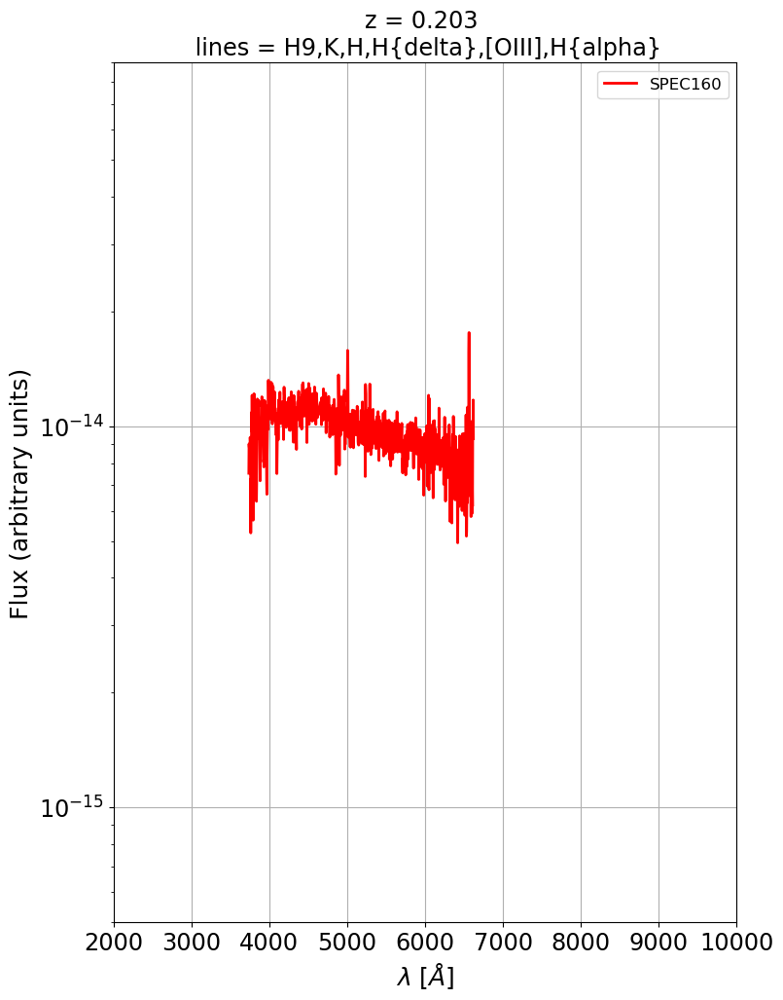

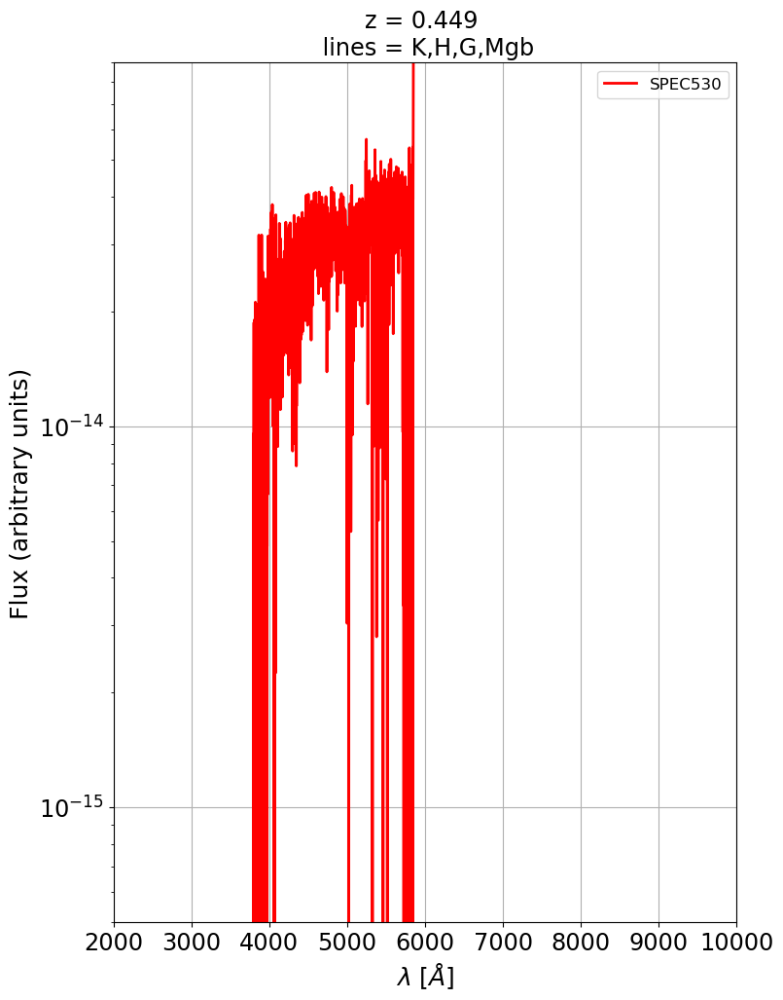

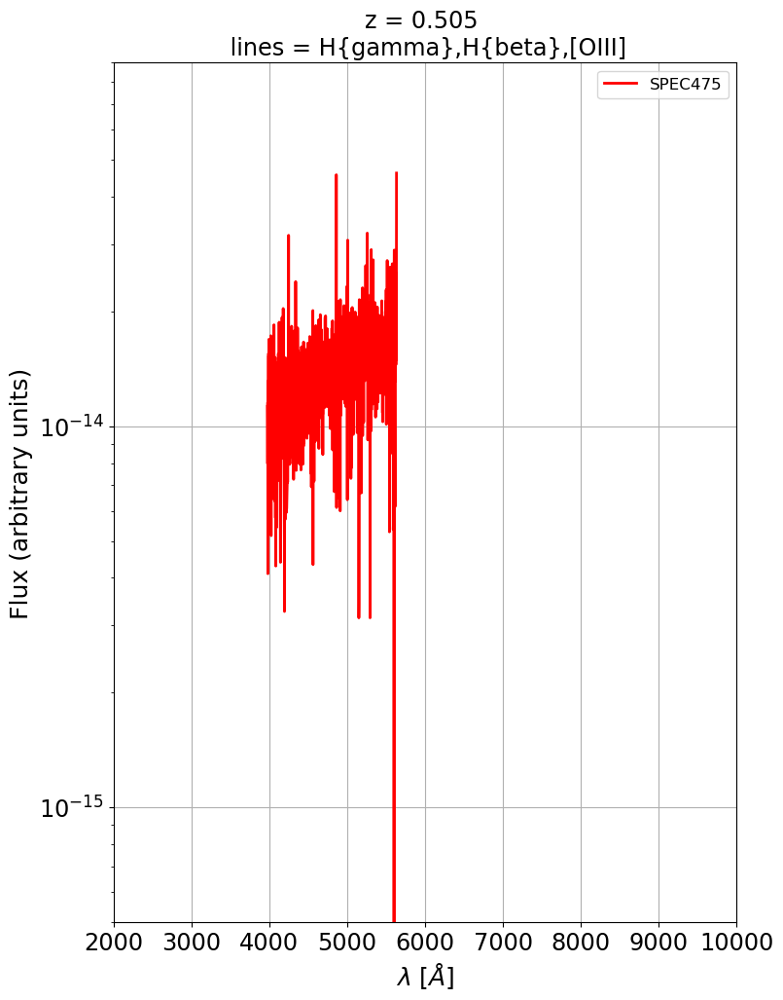

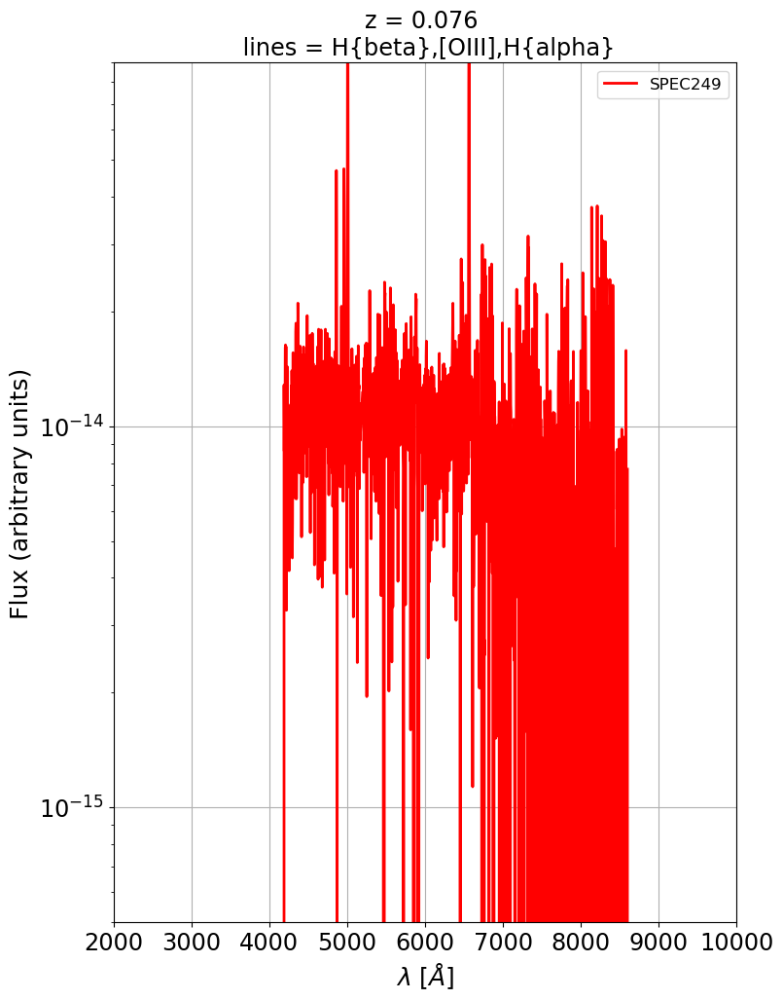

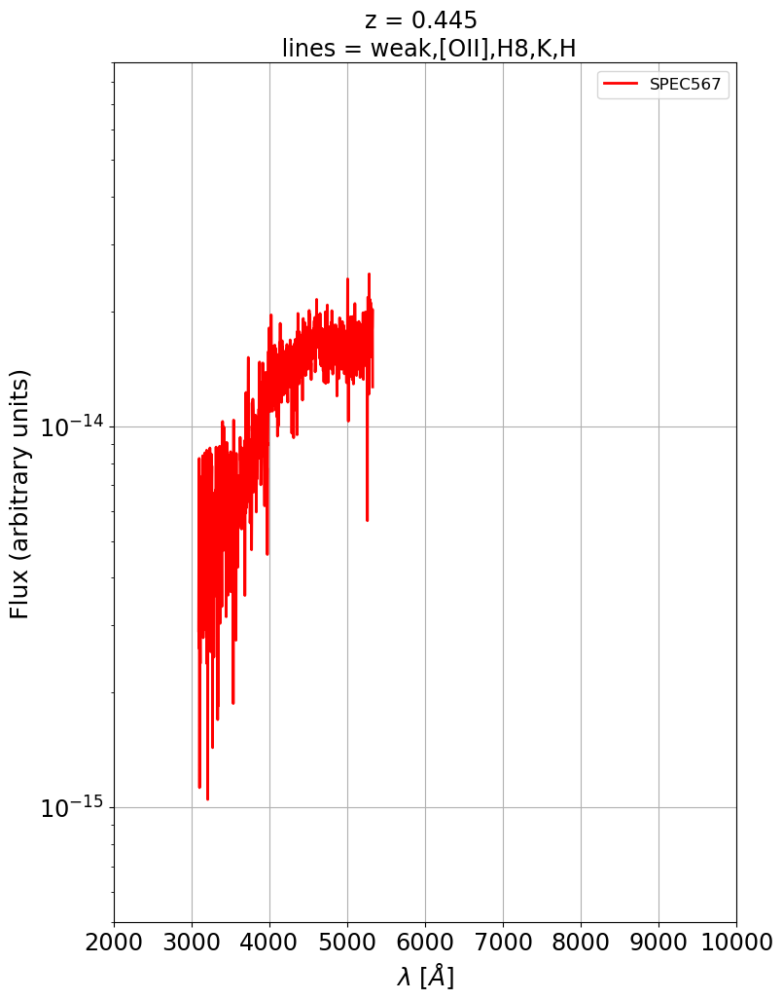

...

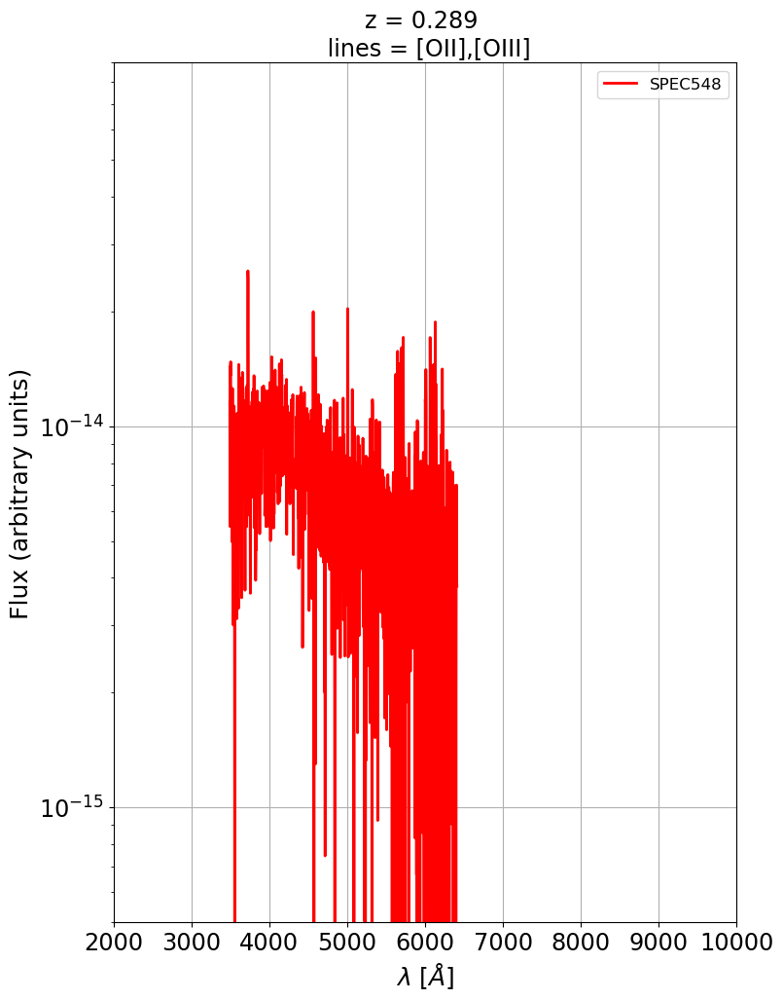

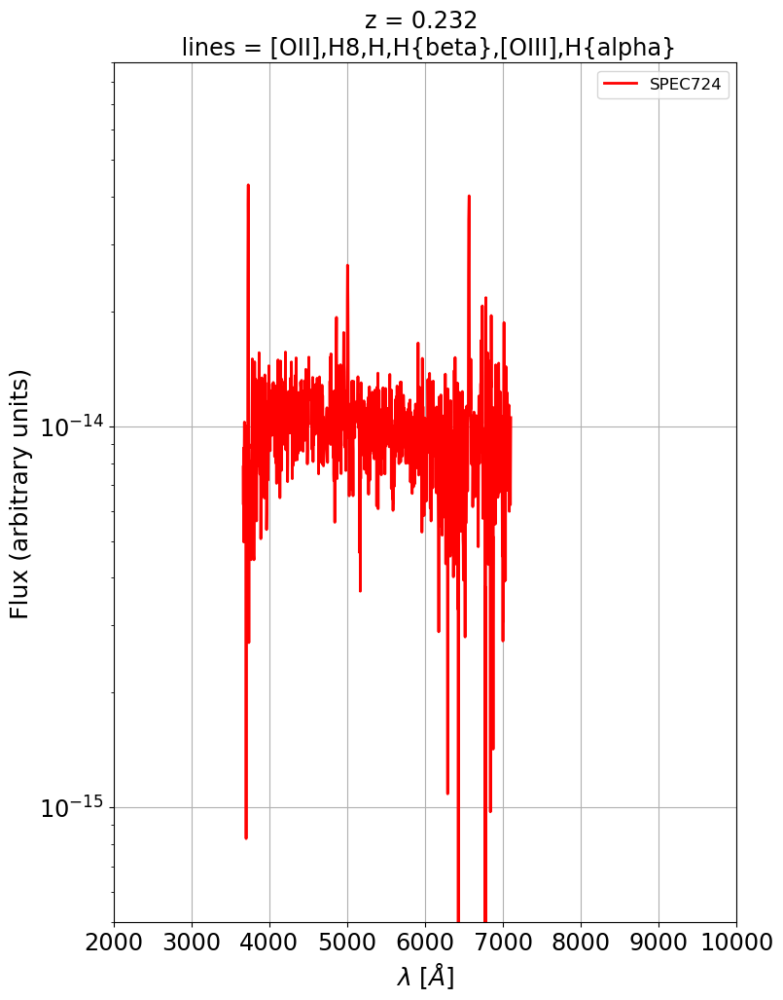

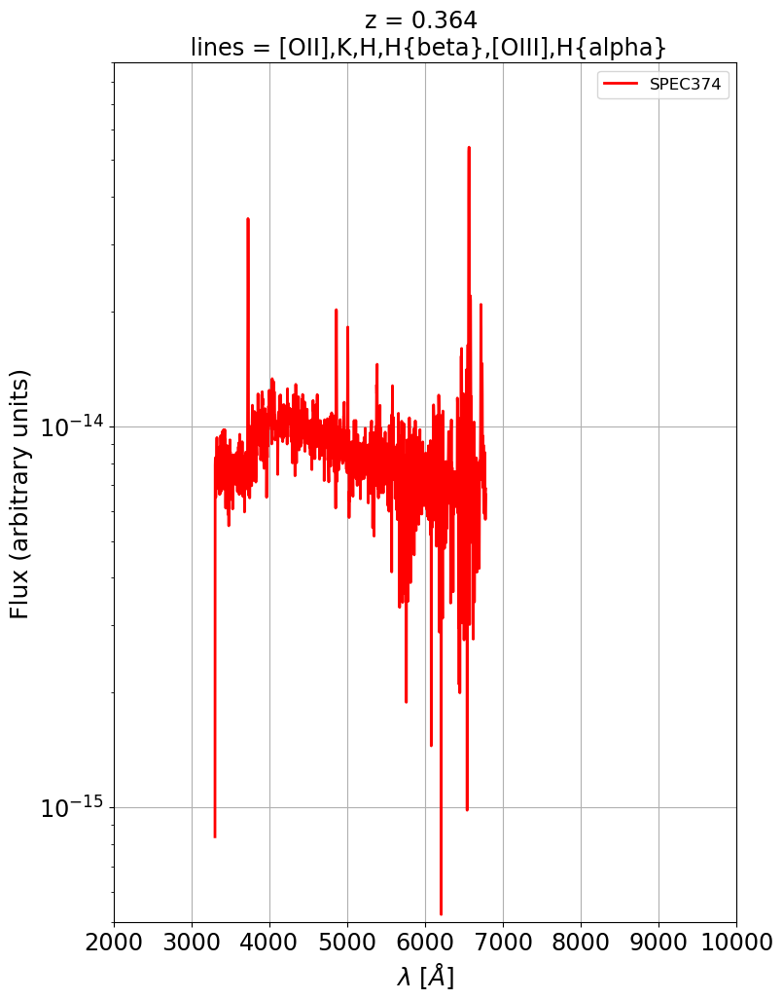

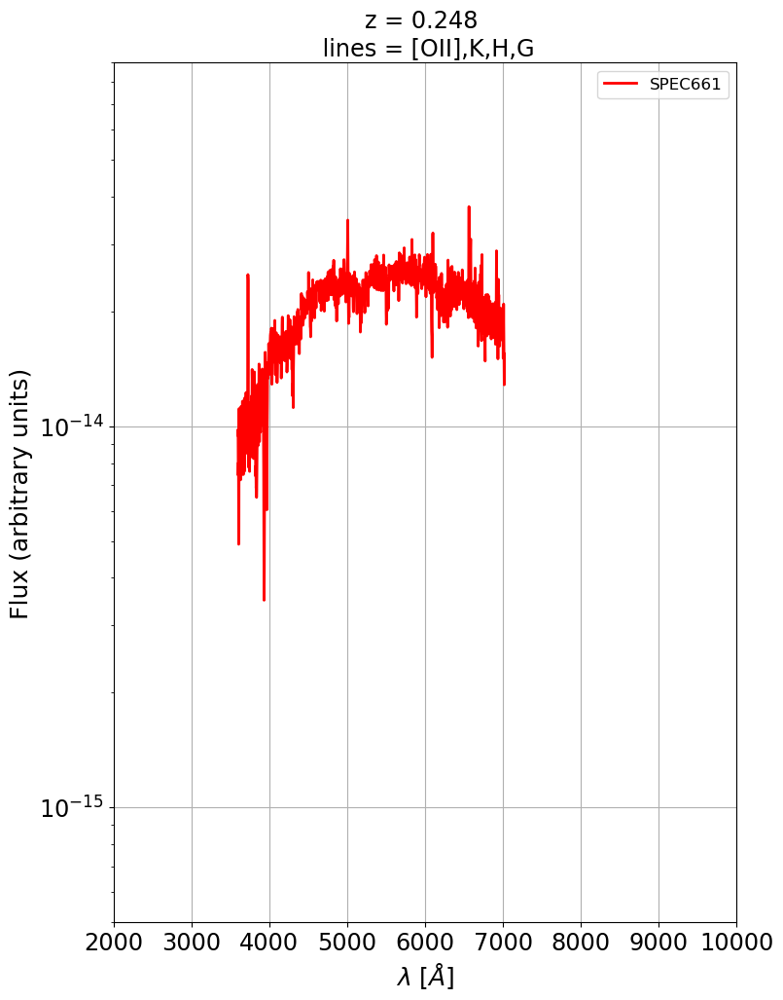

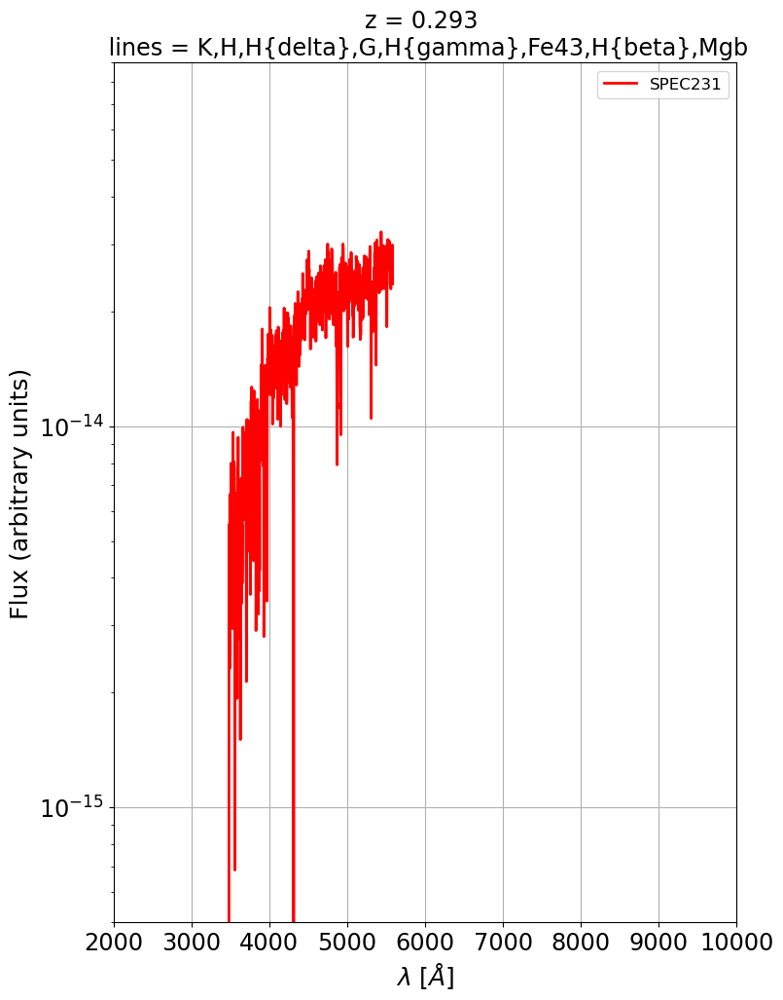

In [51]:
plot_fors2_raw()

('n_sed =', 550)


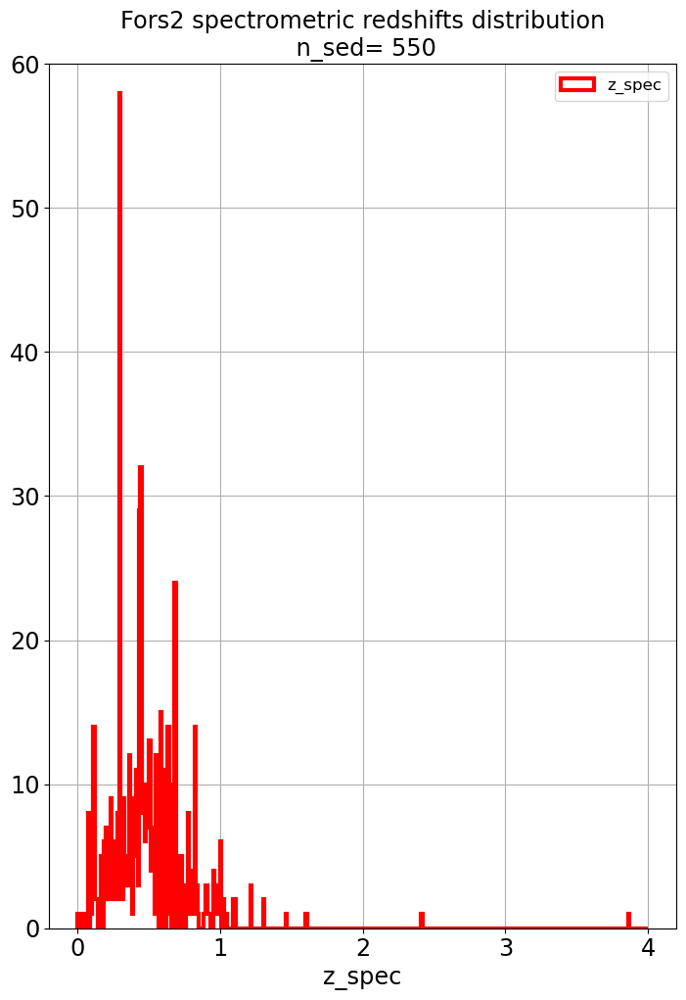

In [52]:
hist_zspec()

In [53]:
count_zspec()

[ 84 149 328]
('0.29266', 3)
SPEC679
SPEC214
SPEC9
[ 84 149 328]
('0.29266', 3)
SPEC679
SPEC214
SPEC9
[ 84 149 328]
('0.29266', 3)
SPEC679
SPEC214
SPEC9


/var/folders/rk/cnrspsj13_3cgmh8p4m_mxww0000gp/T/ipykernel_46235/176011063.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8.27, 11.69), dpi=100)


('red    = ', ['SPEC379', 'SPEC583', 'SPEC570', 'SPEC398', 'SPEC223', 'SPEC562', 'SPEC547', 'SPEC182', 'SPEC376', 'SPEC132', 'SPEC530', 'SPEC721', 'SPEC637', 'SPEC663', 'SPEC277', 'SPEC324', 'SPEC358', 'SPEC304', 'SPEC179', 'SPEC233', 'SPEC171', 'SPEC590', 'SPEC35', 'SPEC711', 'SPEC141', 'SPEC494', 'SPEC490', 'SPEC210', 'SPEC701', 'SPEC566', 'SPEC271', 'SPEC381', 'SPEC661', 'SPEC560', 'SPEC735', 'SPEC58', 'SPEC576', 'SPEC9', 'SPEC598', 'SPEC716', 'SPEC137', 'SPEC446', 'SPEC509', 'SPEC378', 'SPEC617', 'SPEC349', 'SPEC351', 'SPEC118', 'SPEC193', 'SPEC188', 'SPEC649', 'SPEC674', 'SPEC391', 'SPEC359', 'SPEC511', 'SPEC198', 'SPEC55', 'SPEC528', 'SPEC501', 'SPEC355', 'SPEC519', 'SPEC493', 'SPEC695', 'SPEC149', 'SPEC231', 'SPEC443', 'SPEC700', 'SPEC287', 'SPEC632', 'SPEC738', 'SPEC343', 'SPEC506', 'SPEC186', 'SPEC601', 'SPEC463', 'SPEC718', 'SPEC387', 'SPEC334', 'SPEC648', 'SPEC404', 'SPEC218', 'SPEC278', 'SPEC282', 'SPEC288', 'SPEC189', 'SPEC526', 'SPEC33', 'SPEC685', 'SPEC71', 'SPEC235', 'S

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

<Figure size 827x1169 with 0 Axes>

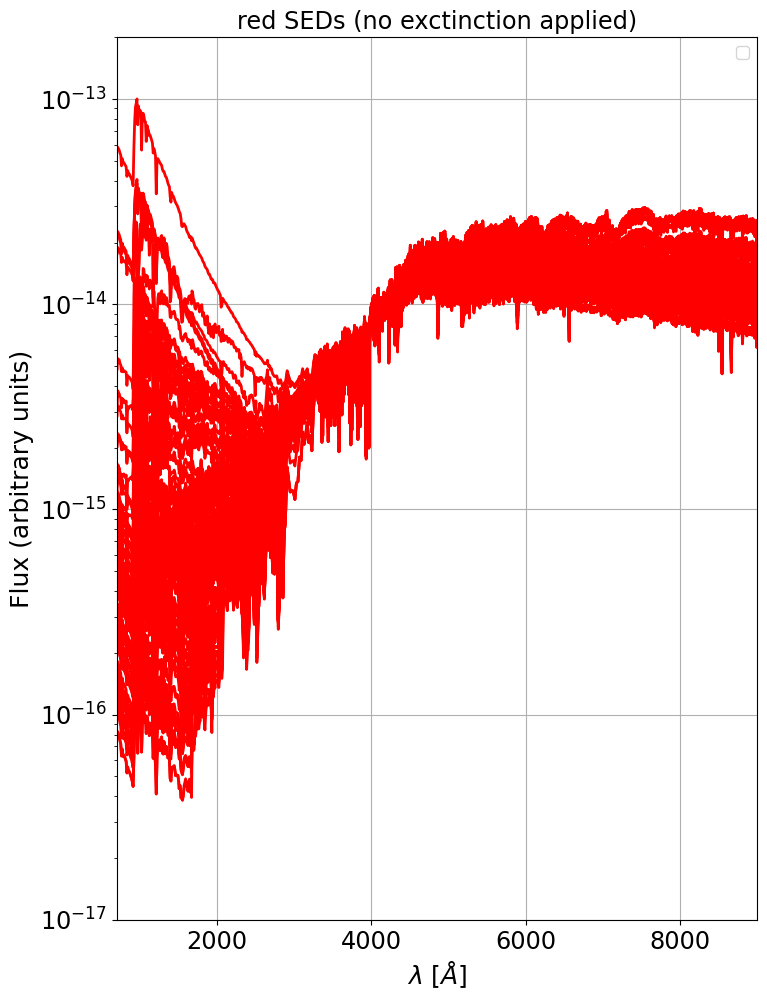

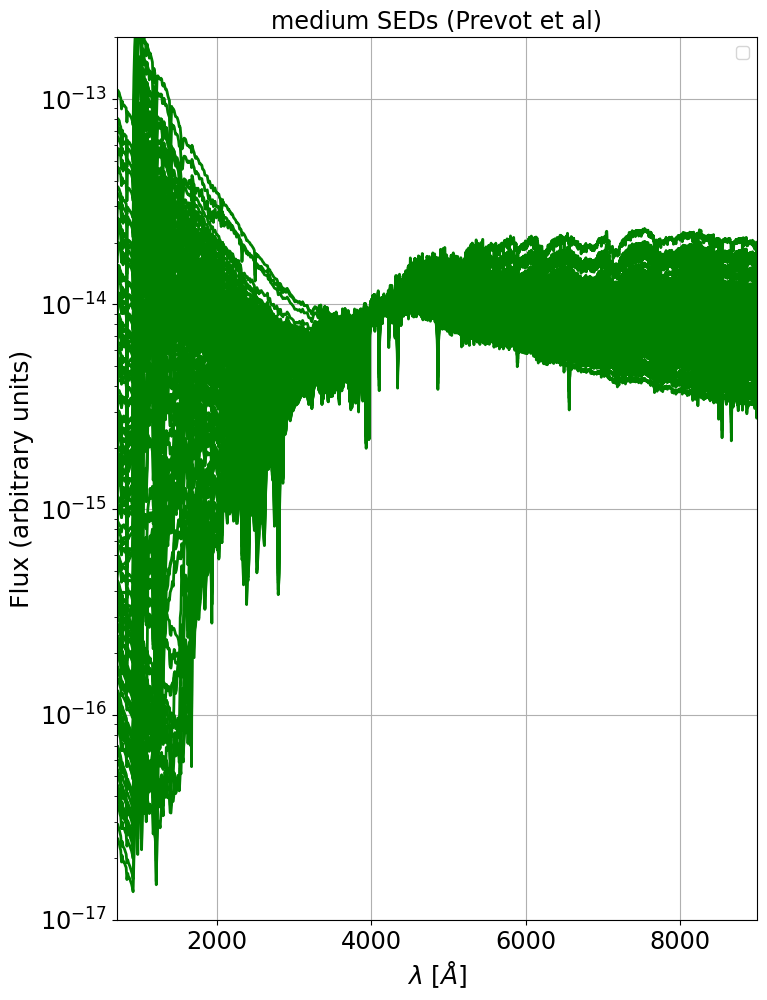

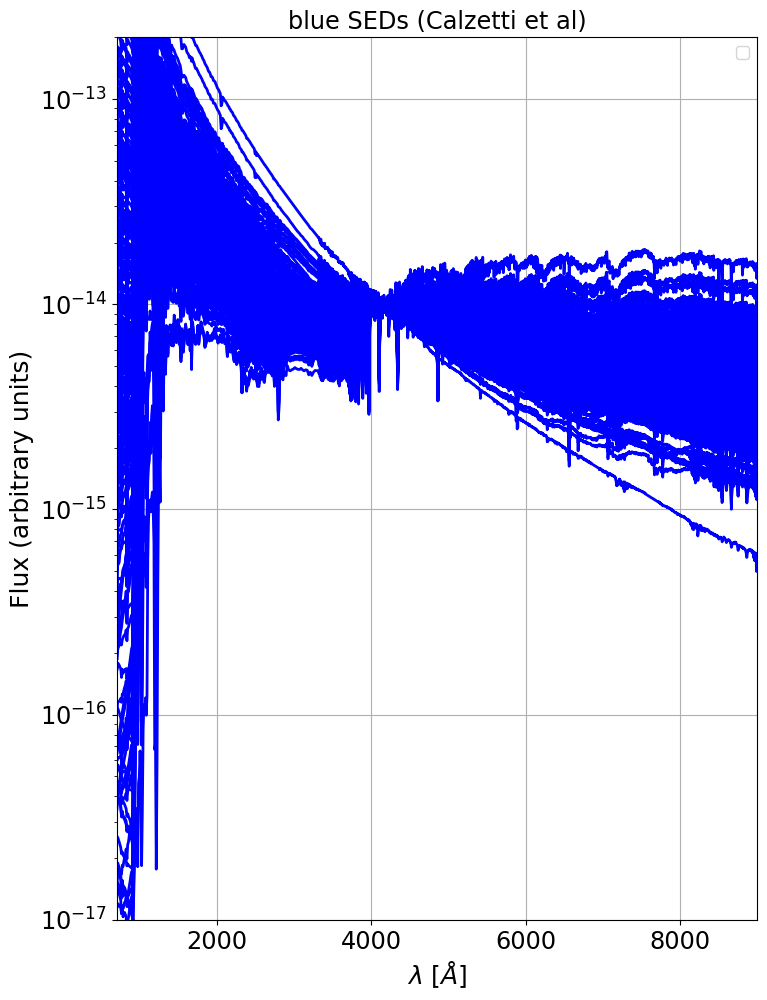

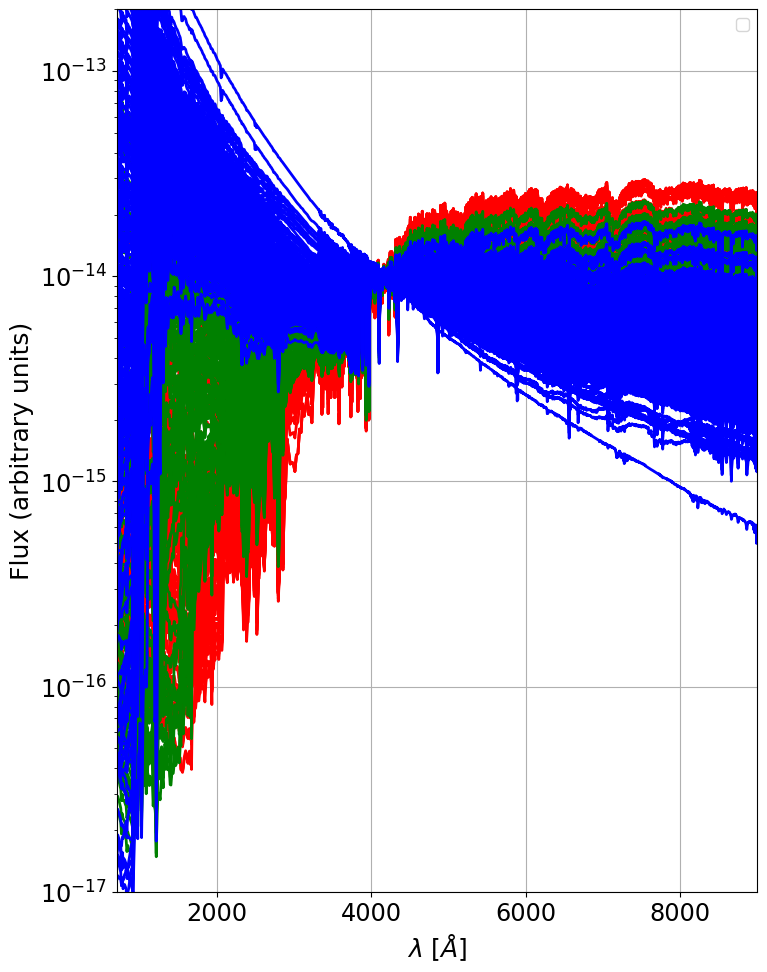

In [54]:
color_sort()